## import packages and color codes

In [1]:
import datetime

print("investigator: Thomas Walle\n")
print('date:')
print(datetime.datetime.now())

# Which python
import sys

sys.path[2]

investigator: Thomas Walle

date:
2021-02-16 11:54:05.809145


'/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8'

In [2]:
# scanpy packages 
import scanpy as sc
import scanpy.external as sce
import anndata as anndata
from anndata import AnnData

# Before importing diffxpy.api or batchglm.api in your python session, execute:
import os
os.environ.setdefault("TF_NUM_THREADS", "1")
os.environ.setdefault("TF_LOOP_PARALLEL_ITERATIONS", "1")
import diffxpy.api as de

#other packages
import time
import os
import numpy as np
import seaborn as sns
import pandas as pd
import re
import h5py
from copy import deepcopy
from colors import rgb, hex
import scipy.cluster.hierarchy as hc
import scipy as scipy
from scipy.stats import ttest_ind
from scipy.sparse import csr_matrix
import colors as colors

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as patches
import matplotlib.colors as colors
import matplotlib.font_manager
from matplotlib import rcParams

# other packages
import glob
from collections import OrderedDict
from scipy.sparse import csr_matrix
import scipy.stats
from statistics import median
from statistics import mean
from scanpy.external.pp import magic
from kneed import KneeLocator
import doubletdetection
import gseapy as gp


In [3]:
import pkg_resources
import types
def get_imports():
    for name, val in globals().items():
        if isinstance(val, types.ModuleType):
            # Split ensures you get root package, 
            # not just imported function
            name = val.__name__.split(".")[0]

        elif isinstance(val, type):
            name = val.__module__.split(".")[0]


        poorly_named_packages = {
            "PIL": "Pillow",
            "sklearn": "scikit-learn"
        }
        if name in poorly_named_packages.keys():
            name = poorly_named_packages[name]

        yield name
imports = list(set(get_imports()))


requirements = []
for m in pkg_resources.working_set:
    if m.project_name in imports and m.project_name!="pip":
        requirements.append((m.project_name, m.version))

for r in requirements:
    print("{}=={}".format(*r))

seaborn==0.11.0
scipy==1.5.3
scanpy==1.6.0
pandas==1.0.3
numpy==1.18.1
matplotlib==3.1.3
magic==0.1.1
kneed==0.7.0
h5py==2.10.0
gseapy==0.9.17
doubletdetection==2.5.2
diffxpy==0.7.4
anndata==0.7.4


In [4]:
# FUNCTIONS

# Randomize cells for plotting UMAP
def randomize_cells(anndata_object):
    
    "Randomize cells for plotting UMAP"
    
    index_list = np.arange(anndata_object.shape[0])
    np.random.shuffle(index_list)
    anndata_object = anndata_object[index_list]
    
    return anndata_object

In [5]:
# define colors

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=80,frameon=False, vector_friendly=True, fontsize=7, figsize=(10,10), color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')

color_map_clusters = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
"#FFDBE5", "#7A4900", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

godsnot_64 = [
    # "#000000",  # remove the black, as often, we have black colored annotation
    "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
    "#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
    "#5A0007", "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
    "#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
    "#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
    "#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
    "#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
    "#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
    "#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
    "#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
    "#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
    "#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
    "#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72"]

color_map_bimodal = ['#e1e1e1','#FF4A46']

color_map_clusters_plt = cm = LinearSegmentedColormap.from_list(
        'color_map_clusters', color_map_clusters)

# load raw data

In [6]:
directory_path_sparse_matrices = "/data/peer/wallet/raw_data/PDAC_dev_Lowe_2020/**/**/*.csv"
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data.h5ad'

In [7]:
#load .csv seqc output count matrices

# load files (indicate your datapath here)

files = glob.glob(directory_path_sparse_matrices)

# load counts
counts_dict = OrderedDict()
for file in files:
    sample = file.split("/")[-1].split("_P170_dense.csv")[0]
    counts = pd.read_csv(file, index_col = 0)
    # Convert to int32
    counts = counts.astype(np.int32)
    counts_dict[sample] = counts
    


In [8]:
files

['/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/input_data/scrnaseq/dense_matrices/CRR034528/seqc-results/sample_N09_dense.csv',
 '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/input_data/scrnaseq/dense_matrices/CRR034502/seqc-results/sample_T07_dense.csv',
 '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/input_data/scrnaseq/dense_matrices/CRR034498/seqc-results/sample_T03_dense.csv',
 '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/input_data/scrnaseq/dense_matrices/CRR034504/seqc-results/sample_T09_dense.csv',
 '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/input_data/scrnaseq/dense_matrices/CRR034496/seqc-results/sample_T01_dense.csv',
 '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/input_data/scrnaseq/dense_matrices/CRR034521/seqc-results/sample_N0

In [10]:
#order dict by sample names
counts_dict = OrderedDict(sorted(counts_dict.items(), key=lambda x: x))
counts_dict.keys()
for sample in counts_dict:
    counts_dict[sample].index.name = 'cell_barcodes'
    counts_dict[sample].index = counts_dict[sample].index.astype(str)

In [11]:
# check for repeated column gene names
for sample in counts_dict:
    num_all_genes = len(counts_dict[sample].columns.values)
    num_set_genes = len(set(counts_dict[sample].columns.values))
    if num_all_genes != num_set_genes:
        raise ValueError(sample+' has repeated genes (columns)')
    else:
        print(sample+' does NOT have repeated genes')

sample_N01_dense.csv does NOT have repeated genes
sample_N02_dense.csv does NOT have repeated genes
sample_N03_dense.csv does NOT have repeated genes
sample_N04_dense.csv does NOT have repeated genes
sample_N05_dense.csv does NOT have repeated genes
sample_N06_dense.csv does NOT have repeated genes
sample_N07_dense.csv does NOT have repeated genes
sample_N08_dense.csv does NOT have repeated genes
sample_N09_dense.csv does NOT have repeated genes
sample_N10_dense.csv does NOT have repeated genes
sample_N11_dense.csv does NOT have repeated genes
sample_T01_dense.csv does NOT have repeated genes
sample_T02_dense.csv does NOT have repeated genes
sample_T03_dense.csv does NOT have repeated genes
sample_T04_dense.csv does NOT have repeated genes
sample_T06_dense.csv does NOT have repeated genes
sample_T07_dense.csv does NOT have repeated genes
sample_T08_dense.csv does NOT have repeated genes
sample_T09_dense.csv does NOT have repeated genes
sample_T10_dense.csv does NOT have repeated genes


In [12]:
#drop cluster column
for sample in counts_dict:
  counts_dict[sample].drop(columns = "CLUSTER", inplace=True)

In [13]:
counts_dict

OrderedDict([('sample_N01_dense.csv',
                               TSPAN6  TNMD  DPM1  SCYL3  C1ORF112  FGR  CFH  FUCA2  GCLC  \
              cell_barcodes                                                                 
              120703408848099       0     0     0      0         0    0    0      0     0   
              120703408880541       0     0     0      0         0    0    0      0     0   
              120703409108717       1     0     0      0         0    0    0      0     0   
              120703409637149       0     0     0      0         0    0    0      1     0   
              120703423764702       0     0     0      0         0    0    0      1     0   
              ...                 ...   ...   ...    ...       ...  ...  ...    ...   ...   
              241114608163619       0     0     1      0         0    0    0      0     0   
              241114608462756       0     0     1      0         0    0    5      0     0   
              241114608712556   

In [14]:
#convert DataFrames to AnnData object
adata_dict = dict()
for sample in counts_dict:    
    adata_dict[sample] = sc.AnnData(
        X=np.array(counts_dict[sample]),
        obs={'obs_names': counts_dict[sample].index.astype(str)},
        var={'var_names': counts_dict[sample].columns.values}
    )

In [15]:
#### Convert AnnData's to crs_matrices

#Generally, if you have sparse data that are stored as a dense matrix
#, you can dramatically improve performance and reduce disk space by converting to a csr_matrix.

for sample in adata_dict:
    adata_dict[sample].X = csr_matrix(adata_dict[sample].X)

In [16]:
### Concatenate AnnDatas to one single AnnData
adata_lst = [adata_dict[adata] for adata in list(adata_dict.keys())]

In [17]:
#specify batches
batches = list(adata_dict.keys())
batches

adata = adata_lst[0].concatenate(
    adata_lst[1:],
    join='outer',
    batch_categories=batches,
    index_unique='-'
)

In [18]:
set(adata.obs['batch'])

{'sample_N01_dense.csv',
 'sample_N02_dense.csv',
 'sample_N03_dense.csv',
 'sample_N04_dense.csv',
 'sample_N05_dense.csv',
 'sample_N06_dense.csv',
 'sample_N07_dense.csv',
 'sample_N08_dense.csv',
 'sample_N09_dense.csv',
 'sample_N10_dense.csv',
 'sample_N11_dense.csv',
 'sample_T01_dense.csv',
 'sample_T02_dense.csv',
 'sample_T03_dense.csv',
 'sample_T04_dense.csv',
 'sample_T06_dense.csv',
 'sample_T07_dense.csv',
 'sample_T08_dense.csv',
 'sample_T09_dense.csv',
 'sample_T10_dense.csv',
 'sample_T11_dense.csv',
 'sample_T12_dense.csv',
 'sample_T13_dense.csv',
 'sample_T14_dense.csv',
 'sample_T15_dense.csv',
 'sample_T16_dense.csv',
 'sample_T17_dense.csv',
 'sample_T18_dense.csv',
 'sample_T19_dense.csv',
 'sample_T20_dense.csv',
 'sample_T21_dense.csv',
 'sample_T22_dense.csv',
 'sample_T23_dense.csv',
 'sample_T24_dense.csv'}

## write data

In [19]:
#write adata
adata.write(adata_save_path)

## annotate data

In [20]:
#continue with your adata here
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated.h5ad'

In [21]:
adata_df = sc.read(adata_path)

In [22]:
adata_df.obs

,batch
cell_barcodes,
120703408848099-sample_N01_dense.csv,sample_N01_dense.csv
120703408880541-sample_N01_dense.csv,sample_N01_dense.csv
120703409108717-sample_N01_dense.csv,sample_N01_dense.csv
120703409637149-sample_N01_dense.csv,sample_N01_dense.csv
120703423764702-sample_N01_dense.csv,sample_N01_dense.csv
...,...
241114589842348-sample_T24_dense.csv,sample_T24_dense.csv
241114589907291-sample_T24_dense.csv,sample_T24_dense.csv
241114607906037-sample_T24_dense.csv,sample_T24_dense.csv


In [23]:
adata_df.obs['cell_ID'] = adata_df.obs.index
adata_df.obs['cell_ID'] = adata_df.obs['cell_ID'].str.slice(start=0, stop = -10) # modify cell_ID name
adata_df.obs['batch'] = adata_df.obs['batch'].str.slice(start=0, stop=-10).str.slice(start=7) #modify batch name

In [27]:
adata_df.obs

,batch
cell_ID,
120703408848099-sample_N01,N01
120703408880541-sample_N01,N01
120703409108717-sample_N01,N01
120703409637149-sample_N01,N01
120703423764702-sample_N01,N01
...,...
241114589842348-sample_T24,T24
241114589907291-sample_T24,T24
241114607906037-sample_T24,T24


In [28]:
#select only tumor samples
adata_df.obs['primary_tumor'] = adata_df.obs['batch'].str.contains('T')

In [29]:
adata_df.obs

,batch,primary_tumor
cell_ID,,
120703408848099-sample_N01,N01,False
120703408880541-sample_N01,N01,False
120703409108717-sample_N01,N01,False
120703409637149-sample_N01,N01,False
120703423764702-sample_N01,N01,False
...,...,...
241114589842348-sample_T24,T24,True
241114589907291-sample_T24,T24,True
241114607906037-sample_T24,T24,True


In [30]:
adata_df.write(adata_save_path)

... storing 'batch' as categorical


# Continue after notebook 2021_PDAC_RT_Huber_Peer_DropletUtils.ipynb

# remove empty droplets

In [51]:
adata_df_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated.h5ad'
adata_df_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops.h5ad'

In [31]:
adata_df = sc.read(adata_df_path)

In [32]:
#load empty drop outputs
data_dir = "~/input_data/scrnaseq/empty_drops/sparse_matrices"
sample_names = sorted(
   [name for name in os.listdir(data_dir) if "." not in name])
sample_names

['N01',
 'N02',
 'N03',
 'N04',
 'N05',
 'N06',
 'N07',
 'N08',
 'N09',
 'N10',
 'N11',
 'T01',
 'T02',
 'T03',
 'T04',
 'T06',
 'T07',
 'T08',
 'T09',
 'T10',
 'T11',
 'T12',
 'T13',
 'T14',
 'T15',
 'T16',
 'T17',
 'T18',
 'T19',
 'T20',
 'T21',
 'T22',
 'T23',
 'T24']

## append the different csv files

In [33]:
print(sample_names)

['N01', 'N02', 'N03', 'N04', 'N05', 'N06', 'N07', 'N08', 'N09', 'N10', 'N11', 'T01', 'T02', 'T03', 'T04', 'T06', 'T07', 'T08', 'T09', 'T10', 'T11', 'T12', 'T13', 'T14', 'T15', 'T16', 'T17', 'T18', 'T19', 'T20', 'T21', 'T22', 'T23', 'T24']


In [34]:
#loop concatenating the samples

max_index = (len(sample_names)) #indicate max index with 0 indexing
for index, sample in enumerate(sample_names):
    sample = sample_names[index]
    empty_drops_file = data_dir + "/%s/*_emptyDrops_indexed.txt" % sample
    empty_drops = glob.glob(empty_drops_file)[0]
    empty_drops_df = pd.read_csv(empty_drops)
    empty_drops_df = empty_drops_df.set_index('cell_ID')
    empty_drops_df.index = empty_drops_df.index.astype(str) + '-' + sample
    if index == 0:
        merged_df = pd.DataFrame(empty_drops_df)
    else:
        merged_df = pd.concat([empty_drops_df, merged_df])
print(merged_df.shape)

(13212945, 5)


## merge empty drop status with dataframe

### map indices

In [35]:
merged_df['Limited']

cell_ID
120703408781662-T24    False
120703408781734-T24    False
120703408781739-T24    False
120703408782750-T24    False
120703408785309-T24    False
                       ...  
241114608786661-N01    False
241114608789278-N01    False
241114608789726-N01    False
241114608789741-N01    False
241114608789853-N01    False
Name: Limited, Length: 13212945, dtype: bool

In [36]:
adata_df.obs_names

Index(['120703408848099-sample_N01', '120703408880541-sample_N01',
       '120703409108717-sample_N01', '120703409637149-sample_N01',
       '120703423764702-sample_N01', '120703423823212-sample_N01',
       '120703423825702-sample_N01', '120703424321780-sample_N01',
       '120703436155300-sample_N01', '120703436311406-sample_N01',
       ...
       '241114562643676-sample_T24', '241114576480492-sample_T24',
       '241114577059116-sample_T24', '241114589542700-sample_T24',
       '241114589584284-sample_T24', '241114589842348-sample_T24',
       '241114589907291-sample_T24', '241114607906037-sample_T24',
       '241114607991021-sample_T24', '241114608430302-sample_T24'],
      dtype='object', name='cell_ID', length=201470)

In [37]:
adata_df.obs_names = adata_df.obs_names.str.slice(start=0,stop=16)+adata_df.obs_names.str.slice(start=23)

In [38]:
adata_df.obs_names

Index(['120703408848099-N01', '120703408880541-N01', '120703409108717-N01',
       '120703409637149-N01', '120703423764702-N01', '120703423823212-N01',
       '120703423825702-N01', '120703424321780-N01', '120703436155300-N01',
       '120703436311406-N01',
       ...
       '241114562643676-T24', '241114576480492-T24', '241114577059116-T24',
       '241114589542700-T24', '241114589584284-T24', '241114589842348-T24',
       '241114589907291-T24', '241114607906037-T24', '241114607991021-T24',
       '241114608430302-T24'],
      dtype='object', name='cell_ID', length=201470)

In [39]:
merged_df

,Total,LogProb,PValue,Limited,FDR
cell_ID,,,,,
120703408781662-T24,4,-16.108348,0.957004,False,1.000000
120703408781734-T24,5,-23.928284,0.865813,False,1.000000
120703408781739-T24,1,-10.075935,0.158484,False,0.811771
120703408782750-T24,6,-27.318095,0.902810,False,1.000000
120703408785309-T24,3,-19.253410,0.494651,False,1.000000
...,...,...,...,...,...
241114608786661-N01,2,-14.720059,0.348965,False,0.965723
241114608789278-N01,5,-24.847763,0.827817,False,1.000000
241114608789726-N01,6,-39.188957,0.281772,False,0.935359


In [40]:
adata_df.obs['LogProb_emptydrops'] = merged_df['LogProb']
adata_df.obs['PValue_emptydrops'] = merged_df['PValue']
adata_df.obs['FDR_emptydrops'] = merged_df['FDR']
adata_df.obs['Limited'] = merged_df['Limited']

In [42]:
adata_df.obs['FDR_emptydrops']

cell_ID
120703408848099-N01    0.004510
120703408880541-N01    0.004510
120703409108717-N01    0.004510
120703409637149-N01    0.004510
120703423764702-N01    0.004510
                         ...   
241114589842348-T24    0.003602
241114589907291-T24    0.003602
241114607906037-T24    0.003602
241114607991021-T24    0.003602
241114608430302-T24    0.003602
Name: FDR_emptydrops, Length: 201470, dtype: float64

In [44]:
#check how many cells are true cells with FDR < 0.05
len(adata[adata_df.obs['FDR_emptydrops']<0.05].obs_names)/len(adata.obs_names)

0.9734203603514171

In [50]:
#check how many of cells with limited p values are true cells. If this is not 1 meaning all cells with limited
#p values are true cells, repeat the emptyDrops.R script increasing the number of iterations
p_value_limited = adata_df[adata_df.obs['Limited']==True]
len(p_value_limited[p_value_limited.obs['FDR_emptydrops']<0.05].obs_names)/len(p_value_limited.obs_names)

1.0

In [52]:
#store raw data in .raw.X
adata_df.raw = adata_df
print(adata_df.raw.X)

  (0, 582)	2.0
  (0, 14989)	1.0
  (0, 27)	1.0
  (0, 18609)	1.0
  (0, 20936)	1.0
  (0, 24757)	1.0
  (0, 19116)	1.0
  (0, 8280)	3.0
  (0, 12690)	1.0
  (0, 12695)	1.0
  (0, 23009)	1.0
  (0, 20795)	1.0
  (0, 16210)	2.0
  (0, 12283)	2.0
  (0, 20861)	1.0
  (0, 23207)	2.0
  (0, 19940)	1.0
  (0, 16153)	1.0
  (0, 12226)	1.0
  (0, 16536)	1.0
  (0, 18813)	1.0
  (0, 4789)	1.0
  (0, 13067)	1.0
  (0, 20863)	1.0
  (0, 4026)	1.0
  :	:
  (201469, 15047)	2.0
  (201469, 6770)	2.0
  (201469, 22437)	1.0
  (201469, 76)	1.0
  (201469, 6775)	1.0
  (201469, 2537)	1.0
  (201469, 15849)	2.0
  (201469, 21396)	1.0
  (201469, 15506)	1.0
  (201469, 15942)	2.0
  (201469, 21020)	1.0
  (201469, 3596)	3.0
  (201469, 11756)	1.0
  (201469, 14994)	1.0
  (201469, 24288)	1.0
  (201469, 22633)	1.0
  (201469, 19550)	6.0
  (201469, 19955)	1.0
  (201469, 9305)	3.0
  (201469, 3688)	1.0
  (201469, 4095)	1.0
  (201469, 14555)	1.0
  (201469, 15559)	1.0
  (201469, 10249)	1.0
  (201469, 3915)	1.0


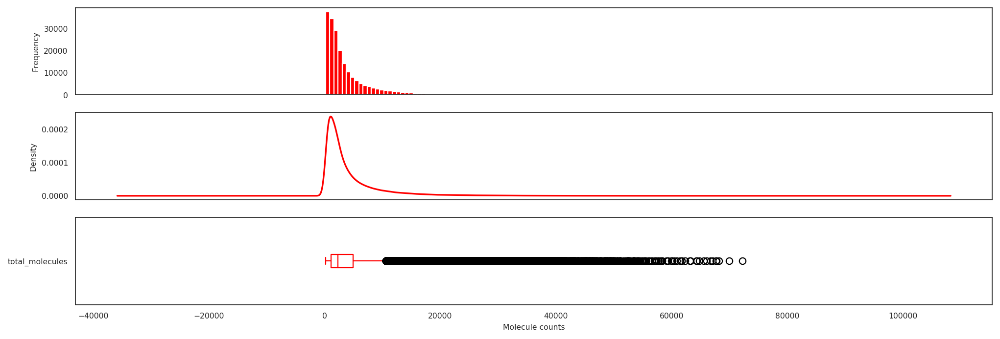

In [53]:
#calculate total molecules
adata_df.obs["total_molecules"] = np.sum(adata_df.X, axis=1)

# PLot counts
a = adata_df.copy()
# Per cell (Total molecules per cell)
fig, (ax1, ax2, ax3) = plt.subplots(nrows=3,
                                    ncols=1,
                                    sharex=True,
                                    figsize=(15, 5))
a.obs["total_molecules"][a.obs["total_molecules"] != 0].plot(kind="hist",
                                                             bins=100,
                                                             ax=ax1,
                                                             color="r")
a.obs["total_molecules"][a.obs["total_molecules"] != 0].plot(kind="kde",
                                                             ax=ax2,
                                                             color="r")
a.obs["total_molecules"][a.obs["total_molecules"] != 0].plot(kind="box",
                                                             vert=False,
                                                             ax=ax3,
                                                             color="r")
x = ax3.set_xlabel("Molecule counts")

In [54]:
print(median(adata_df.obs['total_molecules']))

2323.0


In [55]:
#save adata
adata_df.write(adata_df_save_path)

# QC and library parameters

In [83]:
#paths 
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito.h5ad'

## filter based on cells/gene

In [59]:
#define minimum number of cells per gene and minimum genes per cell
min_cell_number = 20
min_gene_number = 200

(201470, 24817)


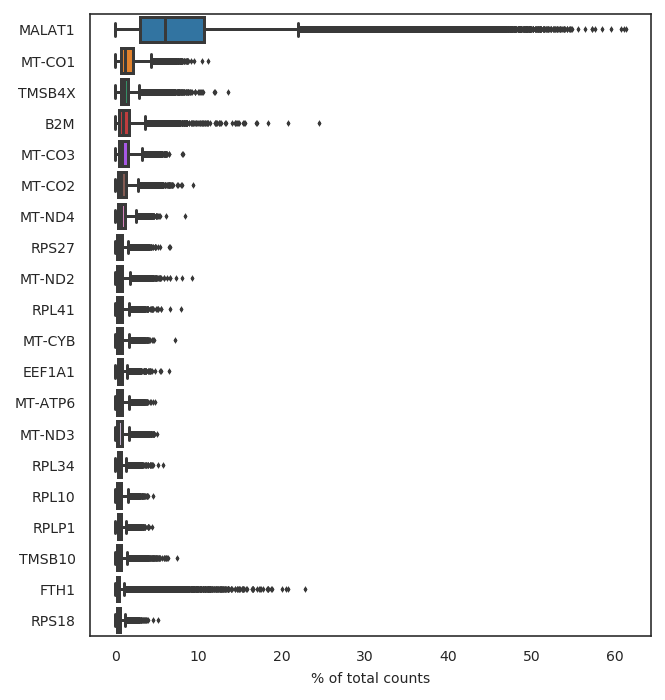

In [56]:
%matplotlib inline
print(adata_df.shape)
sc.pl.highest_expr_genes(adata_df, n_top=20)

(201470, 20962)


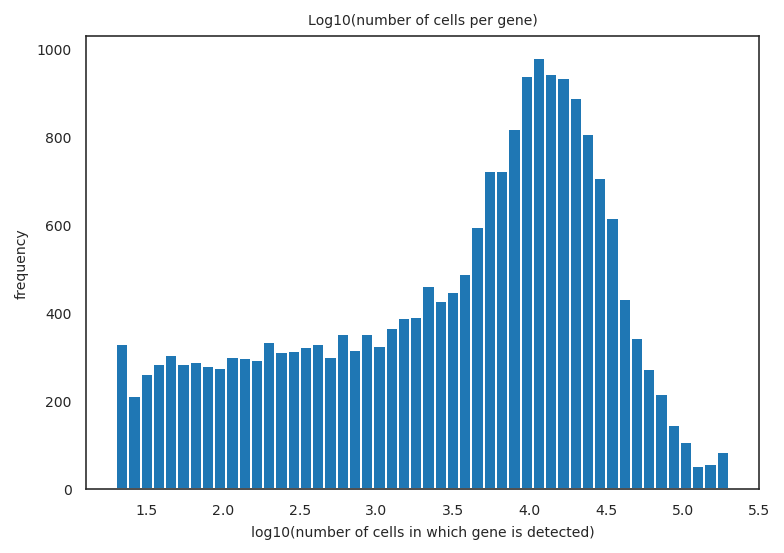

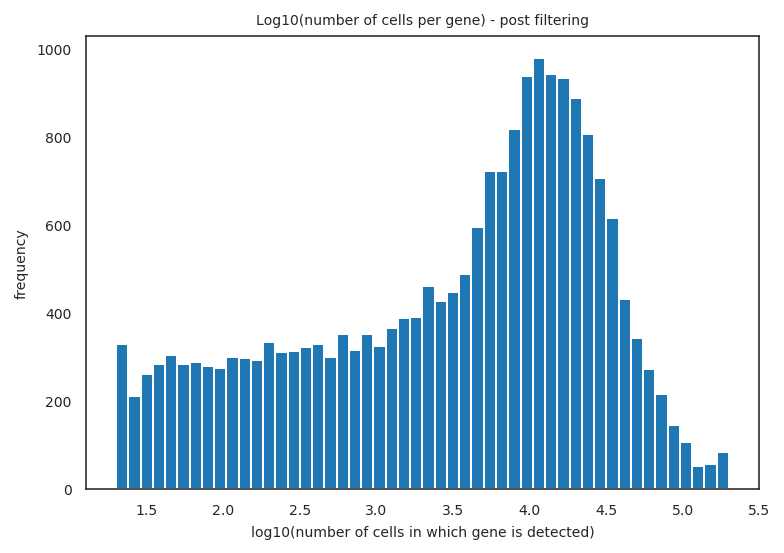

In [58]:
# remove gene just expressed in 20 cells
%matplotlib inline
sc.pp.filter_genes(adata_df,min_cells=min_cell_number)
print(adata_df.shape)

#plot
plt.hist(np.log10(adata_df.var['n_cells']),bins=50)
plt.xlabel('log10(number of cells in which gene is detected)'); plt.ylabel('frequency');plt.title('Log10(number of cells per gene)')
plt.show();plt.close()

sc.pp.filter_genes(adata_df,min_cells=10)

#plot
plt.hist(np.log10(adata_df.var['n_cells']),bins=50)
plt.xlabel('log10(number of cells in which gene is detected)'); plt.ylabel('frequency');plt.title('Log10(number of cells per gene) - post filtering')
plt.show();plt.close()

## filter for minimum number of genes in a given cell

In [60]:
# filter for minimum number of genes that have to be expressed in a given cell
print('adata shape before filtering:', adata_df.shape)
sc.pp.filter_cells(adata_df, min_genes= min_gene_number)
print('adata shape after filtering:', adata_df.shape)

adata shape before filtering: (201470, 20962)
adata shape after filtering: (196887, 20962)


In [61]:
#calculate qc metrics
sc.pp.calculate_qc_metrics(adata_df, inplace = True)

/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-pack

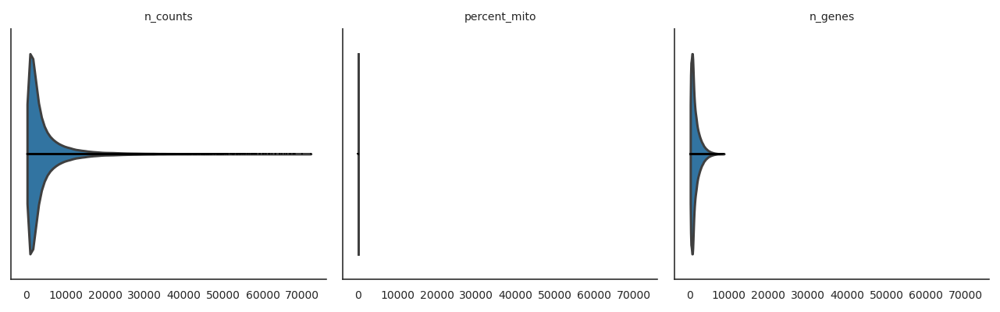

In [62]:
#calculate and show number of mitochondrial genes
mito_genes = adata_df.var_names.str.startswith('MT-')
# for each cell compute fraction of counts in mito genes vs. all genes
# the `` is only necessary as X is sparse (to transform to a dense array after summing)
adata_df.obs['percent_mito'] = np.sum(
    adata_df[:, mito_genes].X, axis=1) / np.sum(adata_df.X, axis=1)
# add the total counts per cell as observations-annotation to adata_df
adata_df.obs['n_counts'] = adata_df.X.sum(axis=1)

sc.pl.violin(adata_df, ['n_counts', 'percent_mito','n_genes'],
             jitter=0, multi_panel=True, stripplot=True)

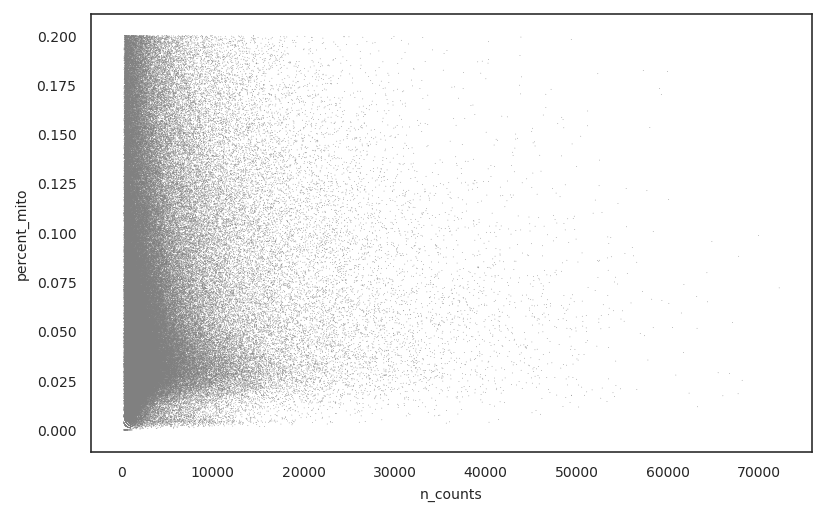

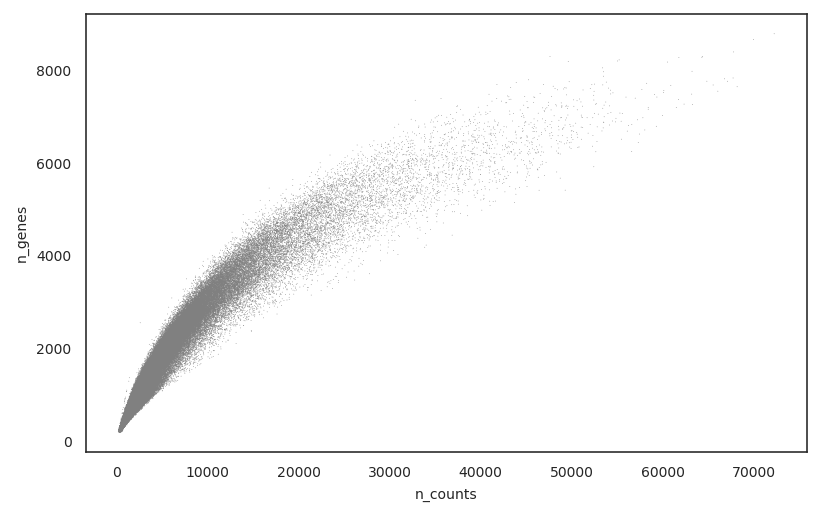

In [63]:
#show the number of mito and counts and genes in scatter
sc.pl.scatter(adata_df, x='n_counts', y='percent_mito')
sc.pl.scatter(adata_df, x='n_counts', y='n_genes')

## remove mito and ribo genes (according to gene name and curated list)

In [67]:
### Calculate ribosomal and mito
malat1 = ["MALAT1"]
mito_genes = [gene for gene in adata_df.var.index if "MT-" == gene[0:3]]
mito_ribos = [gene for gene in adata_df.var.index if "MRPL" == gene[0:3]]
actn_genes = [gene for gene in adata_df.var.index if "ACTN" == gene[0:4]]
riboL_genes = [gene for gene in adata_df.var.index if "RPL" == gene[0:3]]
riboS_genes = [gene for gene in adata_df.var.index if "RPS" == gene[0:3]]
ribo = list(set(riboL_genes+riboS_genes))
ribosomal_genes_df = pd.read_csv("./RB_genes_human.txt", sep="r", header=None)
ribo = set(ribo+list(ribosomal_genes_df[0])) 
ribo = ribo & set(adata_df.var.index)
mito = mito_genes + mito_ribos

In [68]:
ribosomal_genes_df

,0
0,MRPL1
1,MRPL10
2,MRPL11
3,MRPL12
4,MRPL13
...,...
213,RP24-175C20.18
214,RP24-282C4.3
215,RP24-286J21.7
216,RP24-318O6.3


In [31]:
#remove mito ribo genes
print('adata shape before filtering:', adata_df.shape)
remove_genes = set(malat1 + mito + actn_genes +
                   list(ribo))
keep_genes = list(set(adata_df.var.index) - remove_genes)
keep_genes[:5]

adata_df = adata_df[:, keep_genes]
print('adata shape after filtering:', adata_df.shape)

adata shape before filtering: (196887, 20962)
adata shape after filtering: (196887, 20761)


In [32]:
adata_df.write(adata_save_path)

## log1p normalize

In [69]:
print(adata_df.X)

  (0, 25)	1.0
  (0, 55)	3.0
  (0, 68)	1.0
  (0, 348)	2.0
  (0, 444)	1.0
  (0, 452)	1.0
  (0, 453)	1.0
  (0, 460)	2.0
  (0, 516)	1.0
  (0, 524)	2.0
  (0, 527)	4.0
  (0, 536)	2.0
  (0, 666)	1.0
  (0, 700)	2.0
  (0, 802)	1.0
  (0, 834)	1.0
  (0, 884)	1.0
  (0, 893)	1.0
  (0, 901)	1.0
  (0, 951)	1.0
  (0, 981)	1.0
  (0, 987)	1.0
  (0, 1034)	1.0
  (0, 1085)	2.0
  (0, 1098)	1.0
  :	:
  (196886, 19781)	1.0
  (196886, 19833)	1.0
  (196886, 19835)	1.0
  (196886, 19990)	2.0
  (196886, 20021)	1.0
  (196886, 20143)	1.0
  (196886, 20150)	1.0
  (196886, 20180)	1.0
  (196886, 20181)	1.0
  (196886, 20279)	2.0
  (196886, 20310)	1.0
  (196886, 20318)	1.0
  (196886, 20320)	1.0
  (196886, 20333)	4.0
  (196886, 20357)	1.0
  (196886, 20450)	1.0
  (196886, 20492)	2.0
  (196886, 20499)	1.0
  (196886, 20733)	1.0
  (196886, 20748)	1.0
  (196886, 20752)	1.0
  (196886, 20795)	1.0
  (196886, 20797)	1.0
  (196886, 20807)	1.0
  (196886, 20822)	1.0


In [70]:
#total count normalization
sc.pp.normalize_total(adata_df, target_sum=None)
#logarithmize +1 the data
sc.pp.log1p(adata_df)

In [71]:
print(adata_df.X)

  (0, 25)	0.7057233
  (0, 55)	1.4050996
  (0, 68)	0.7057233
  (0, 348)	1.1153455
  (0, 444)	0.7057233
  (0, 452)	0.7057233
  (0, 453)	0.7057233
  (0, 460)	1.1153455
  (0, 516)	0.7057233
  (0, 524)	1.1153455
  (0, 527)	1.6294844
  (0, 536)	1.1153455
  (0, 666)	0.7057233
  (0, 700)	1.1153455
  (0, 802)	0.7057233
  (0, 834)	0.7057233
  (0, 884)	0.7057233
  (0, 893)	0.7057233
  (0, 901)	0.7057233
  (0, 951)	0.7057233
  (0, 981)	0.7057233
  (0, 987)	0.7057233
  (0, 1034)	0.7057233
  (0, 1085)	1.1153455
  (0, 1098)	0.7057233
  :	:
  (196886, 19781)	0.8792939
  (196886, 19833)	0.8792939
  (196886, 19835)	0.8792939
  (196886, 19990)	1.3398305
  (196886, 20021)	0.8792939
  (196886, 20143)	0.8792939
  (196886, 20150)	0.8792939
  (196886, 20180)	0.8792939
  (196886, 20181)	0.8792939
  (196886, 20279)	1.3398305
  (196886, 20310)	0.8792939
  (196886, 20318)	0.8792939
  (196886, 20320)	0.8792939
  (196886, 20333)	1.8926288
  (196886, 20357)	0.8792939
  (196886, 20450)	0.8792939
  (196886, 20492)	1.3

In [72]:
print(adata_df.raw.X)

  (0, 582)	2.0
  (0, 14989)	1.0
  (0, 27)	1.0
  (0, 18609)	1.0
  (0, 20936)	1.0
  (0, 24757)	1.0
  (0, 19116)	1.0
  (0, 8280)	3.0
  (0, 12690)	1.0
  (0, 12695)	1.0
  (0, 23009)	1.0
  (0, 20795)	1.0
  (0, 16210)	2.0
  (0, 12283)	2.0
  (0, 20861)	1.0
  (0, 23207)	2.0
  (0, 19940)	1.0
  (0, 16153)	1.0
  (0, 12226)	1.0
  (0, 16536)	1.0
  (0, 18813)	1.0
  (0, 4789)	1.0
  (0, 13067)	1.0
  (0, 20863)	1.0
  (0, 4026)	1.0
  :	:
  (196886, 15047)	2.0
  (196886, 6770)	2.0
  (196886, 22437)	1.0
  (196886, 76)	1.0
  (196886, 6775)	1.0
  (196886, 2537)	1.0
  (196886, 15849)	2.0
  (196886, 21396)	1.0
  (196886, 15506)	1.0
  (196886, 15942)	2.0
  (196886, 21020)	1.0
  (196886, 3596)	3.0
  (196886, 11756)	1.0
  (196886, 14994)	1.0
  (196886, 24288)	1.0
  (196886, 22633)	1.0
  (196886, 19550)	6.0
  (196886, 19955)	1.0
  (196886, 9305)	3.0
  (196886, 3688)	1.0
  (196886, 4095)	1.0
  (196886, 14555)	1.0
  (196886, 15559)	1.0
  (196886, 10249)	1.0
  (196886, 3915)	1.0


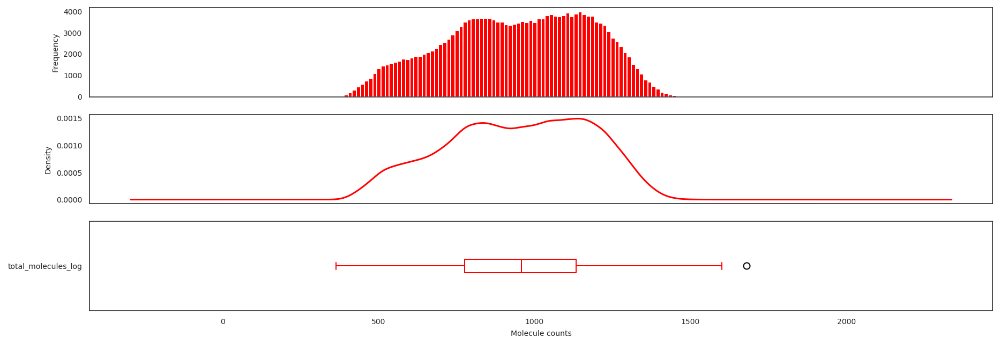

In [77]:
# PLot counts
a = adata_df.copy()
a.obs["total_molecules_log"] = np.sum(adata_df.X, axis=1)
# Per cell (Total molecules per cell)
fig, (ax1, ax2, ax3) = plt.subplots(nrows=3,
                                    ncols=1,
                                    sharex=True,
                                    figsize=(15, 5))
a.obs["total_molecules_log"][a.obs["total_molecules_log"] != 0].plot(kind="hist",
                                                             bins=100,
                                                             ax=ax1,
                                                             color="r")
a.obs["total_molecules_log"][a.obs["total_molecules_log"] != 0].plot(kind="kde",
                                                             ax=ax2,
                                                             color="r")
a.obs["total_molecules_log"][a.obs["total_molecules_log"] != 0].plot(kind="box",
                                                             vert=False,
                                                             ax=ax3,
                                                             color="r")
x = ax3.set_xlabel("Molecule counts")

### write data

In [85]:
adata_df.write(adata_save_path)

In [86]:
adata_df

AnnData object with n_obs × n_vars = 196887 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

# Clustering

In [87]:
#data paths
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered.h5ad'

#parameters
nPC_initial_clustering = 100

In [88]:
adata_ndf_noRBP = sc.read(adata_path)

In [89]:
adata_ndf_noRBP

AnnData object with n_obs × n_vars = 196887 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

## compute umap/tsne to assess visual clustering of leukocytes and batch effects

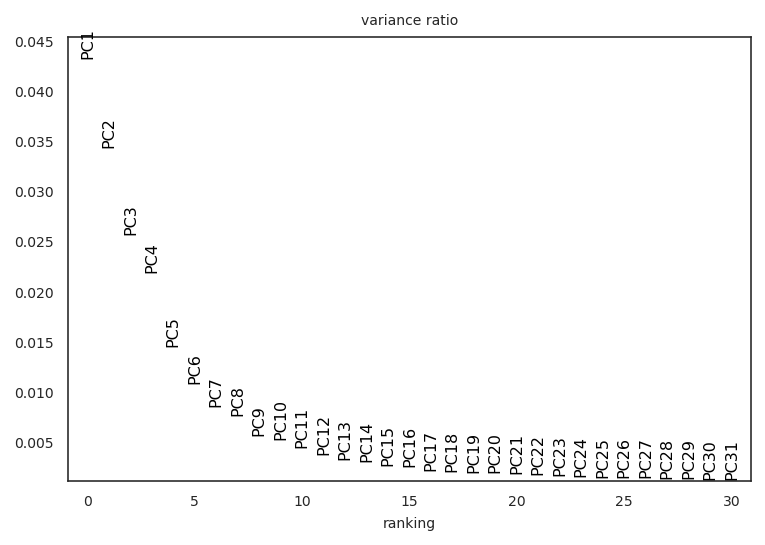

In [90]:
#PCA
sc.pp.pca(adata_ndf_noRBP, n_comps=nPC_initial_clustering, zero_center=True, svd_solver='arpack', random_state=0, return_info=False, use_highly_variable=None, dtype='float32', copy=False, chunked=False, chunk_size=None)
sc.pl.pca_variance_ratio(adata_ndf_noRBP, log=False)

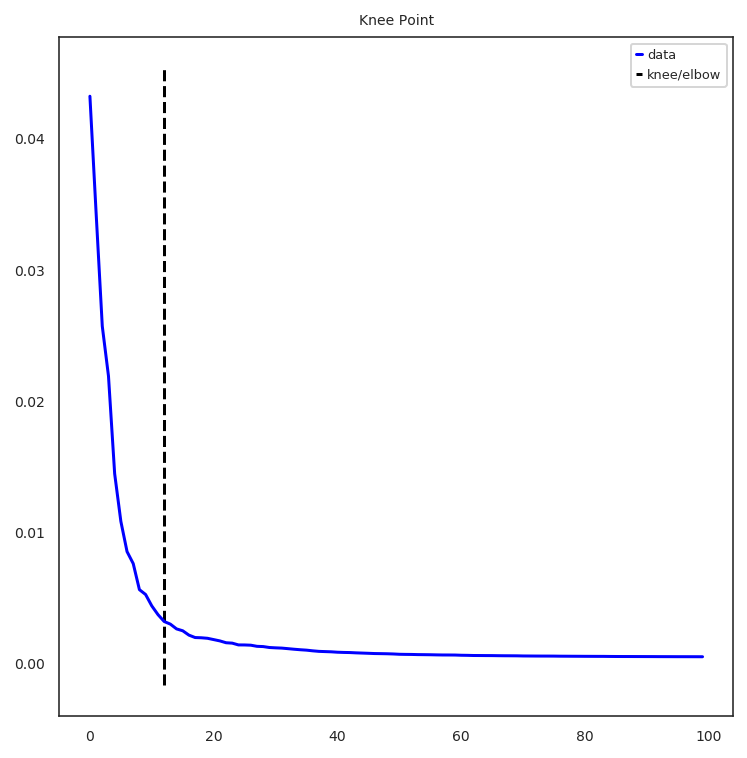

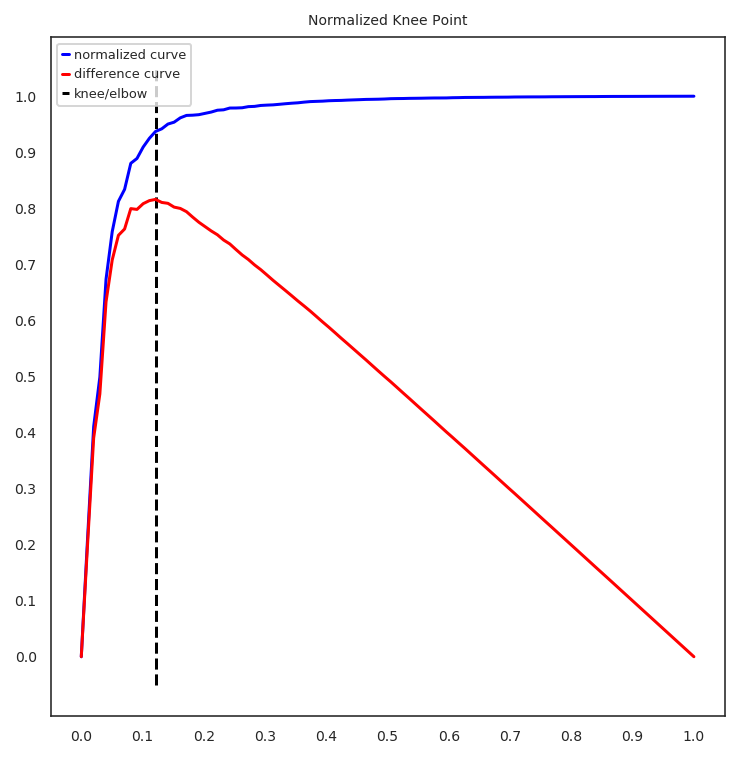

Kneepoint happens at PC: 12
12 PC explain 18.59076807089462 % of variance
18 PC explain 20.15408221507178 % of variance


In [99]:
a = adata_ndf_noRBP.copy()# PCs kneepoint
x = [i for i in range(len(a.uns["pca"]["variance_ratio"]))]
y = list(a.uns["pca"]["variance_ratio"])
kneedle = KneeLocator(x,
                      y,
                      S=1,
                      curve='convex',
                      direction='decreasing',
                      online=False)
kn_pc = round(kneedle.knee, 3)
kneedle.plot_knee()
plt.show()
kneedle.plot_knee_normalized()
plt.show()
print("Kneepoint happens at PC:", kn_pc)

exp_var = sum(adata_ndf_noRBP.uns['pca']['variance_ratio'][:kn_pc])
exp_var_percent = exp_var*100
print(kn_pc,'PC explain',exp_var_percent, '% of variance')

tested_PC_number = 18
exp_var_test = sum(adata_ndf_noRBP.uns['pca']['variance_ratio'][0:tested_PC_number])
exp_var_test_percent = exp_var_test*100
print(tested_PC_number, 'PC explain',exp_var_test_percent, '% of variance')

In [100]:
print(adata_ndf_noRBP.X)

  (0, 25)	0.7057233
  (0, 55)	1.4050996
  (0, 68)	0.7057233
  (0, 348)	1.1153455
  (0, 444)	0.7057233
  (0, 452)	0.7057233
  (0, 453)	0.7057233
  (0, 460)	1.1153455
  (0, 516)	0.7057233
  (0, 524)	1.1153455
  (0, 527)	1.6294844
  (0, 536)	1.1153455
  (0, 666)	0.7057233
  (0, 700)	1.1153455
  (0, 802)	0.7057233
  (0, 834)	0.7057233
  (0, 884)	0.7057233
  (0, 893)	0.7057233
  (0, 901)	0.7057233
  (0, 951)	0.7057233
  (0, 981)	0.7057233
  (0, 987)	0.7057233
  (0, 1034)	0.7057233
  (0, 1085)	1.1153455
  (0, 1098)	0.7057233
  :	:
  (196886, 19781)	0.8792939
  (196886, 19833)	0.8792939
  (196886, 19835)	0.8792939
  (196886, 19990)	1.3398305
  (196886, 20021)	0.8792939
  (196886, 20143)	0.8792939
  (196886, 20150)	0.8792939
  (196886, 20180)	0.8792939
  (196886, 20181)	0.8792939
  (196886, 20279)	1.3398305
  (196886, 20310)	0.8792939
  (196886, 20318)	0.8792939
  (196886, 20320)	0.8792939
  (196886, 20333)	1.8926288
  (196886, 20357)	0.8792939
  (196886, 20450)	0.8792939
  (196886, 20492)	1.3

## define number of PCs as kneepoint or minimal number of PCs so that total variance explained is >20%

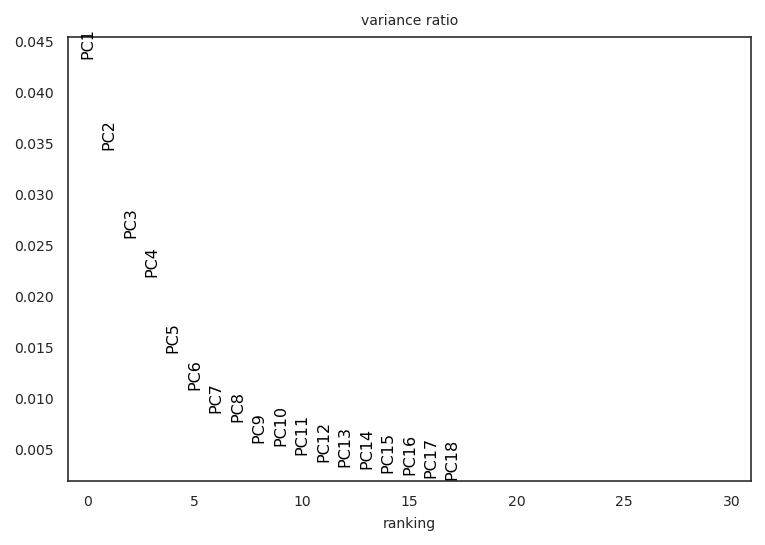

In [101]:
#PCA if not kneepoint is used but other number of PCs change here
kn_pc = 18

sc.pp.pca(adata_ndf_noRBP, n_comps=kn_pc, zero_center=True, svd_solver='arpack', random_state=0, return_info=False, use_highly_variable=None, dtype='float32', copy=False, chunked=False, chunk_size=None)
sc.pl.pca_variance_ratio(adata_ndf_noRBP, log=False)

In [102]:
sc.pp.neighbors(adata_ndf_noRBP, n_neighbors=10, n_pcs=kn_pc)
sc.tl.umap(adata_ndf_noRBP)
## calculate tsne
sc.tl.tsne(adata_ndf_noRBP, random_state = 7)

## Clustering with phenograph

In [103]:
result_pheno_ndf_all = sce.tl.phenograph(adata_ndf_noRBP.obsm['X_pca'], k = 10)
adata_ndf_noRBP.obs['pheno'] = pd.Categorical(result_pheno_ndf_all[0])

Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 97.65692734718323 seconds
Jaccard graph constructed in 64.20170021057129 seconds
Wrote graph to binary file in 5.400257587432861 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.939914
Louvain completed 21 runs in 71.76235842704773 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 294.39844727516174 seconds


In [104]:
adata_ndf_noRBP.write(adata_save_path)

## plot empty drops

In [6]:
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops.h5ad'


In [7]:
adata_ndf_noRBP = sc.read(adata_path)

In [8]:
adata_ndf_noRBP

AnnData object with n_obs × n_vars = 196887 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [9]:
#Limited = empty drops parameter as category
adata_ndf_noRBP.obs['Limited'] = pd.Categorical(adata_ndf_noRBP.obs['Limited'])

In [10]:
adata_ndf_noRBP = randomize_cells(adata_ndf_noRBP)

Trying to set attribute `.uns` of view, copying.


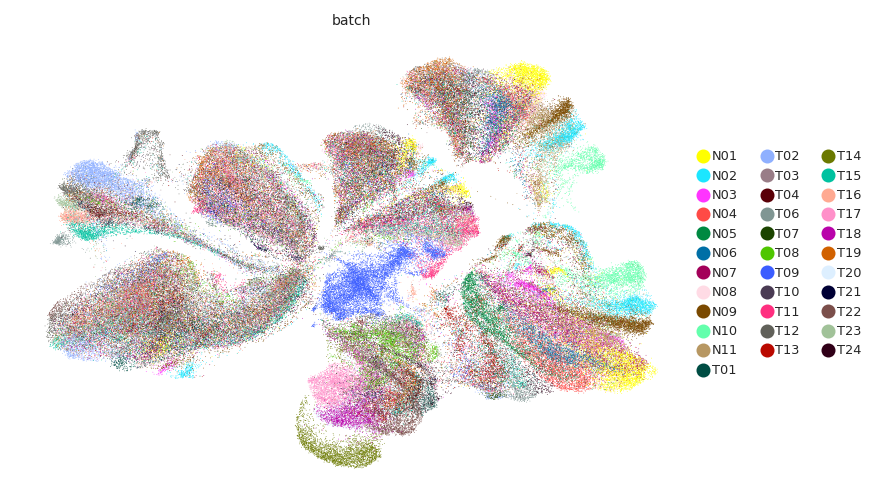

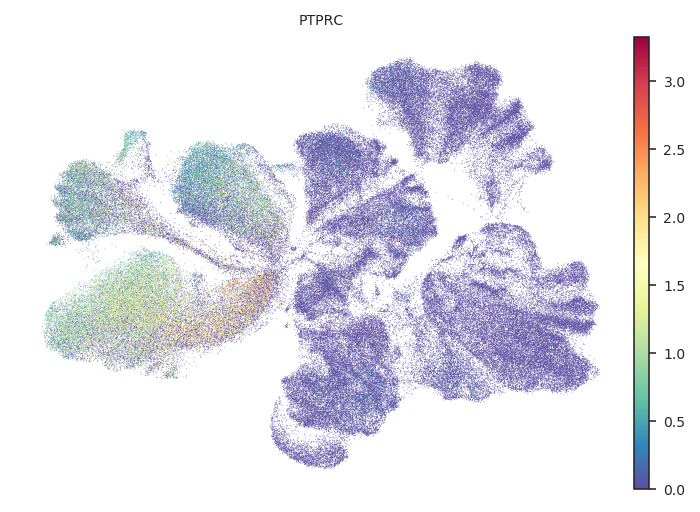

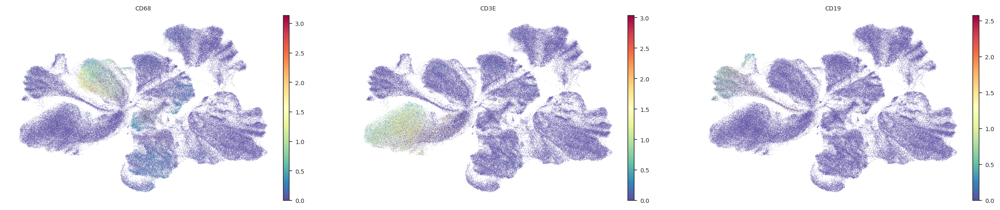

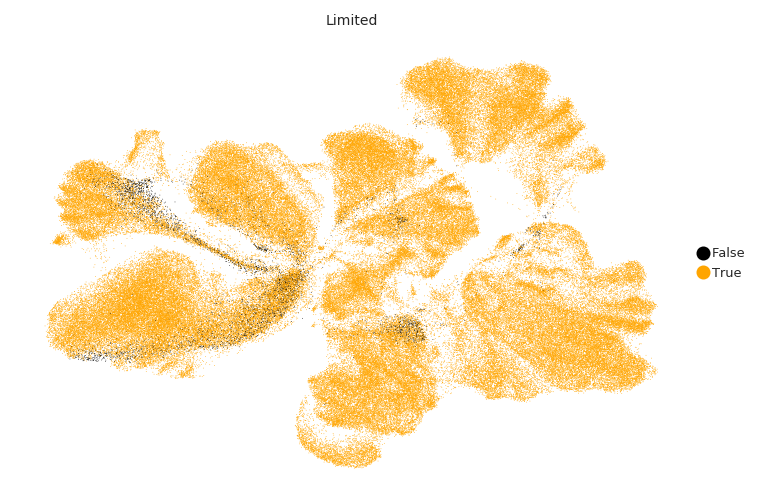

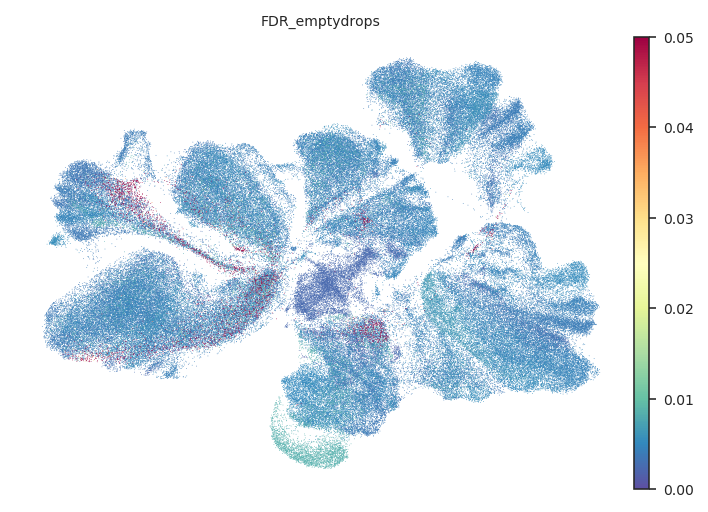

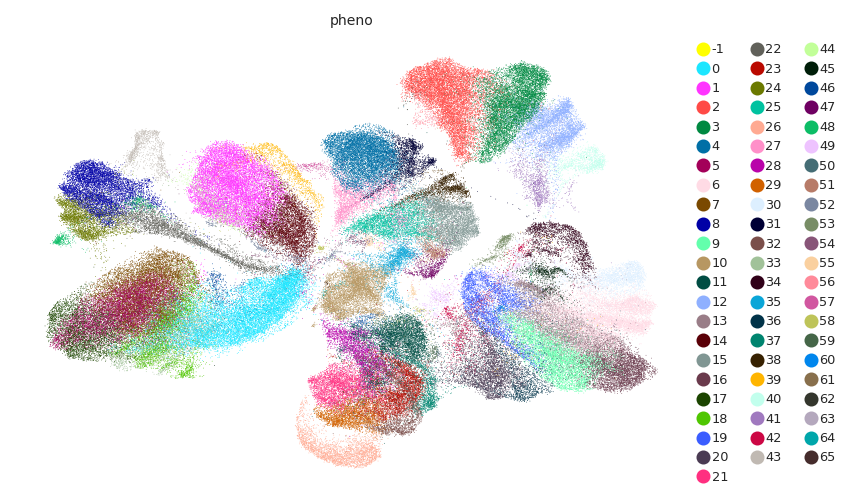

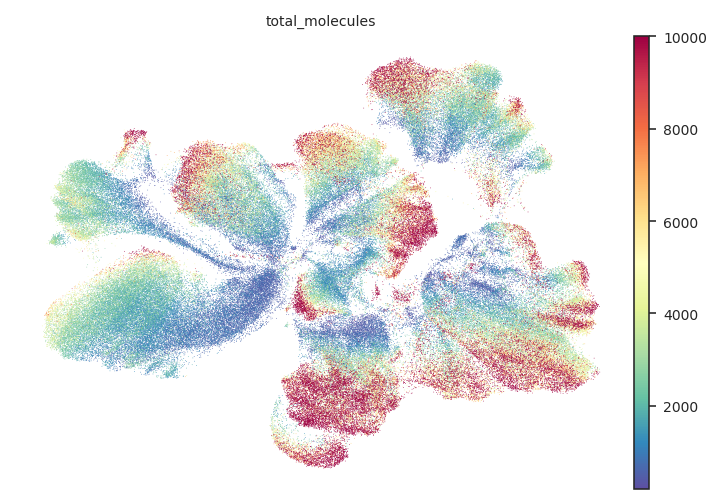

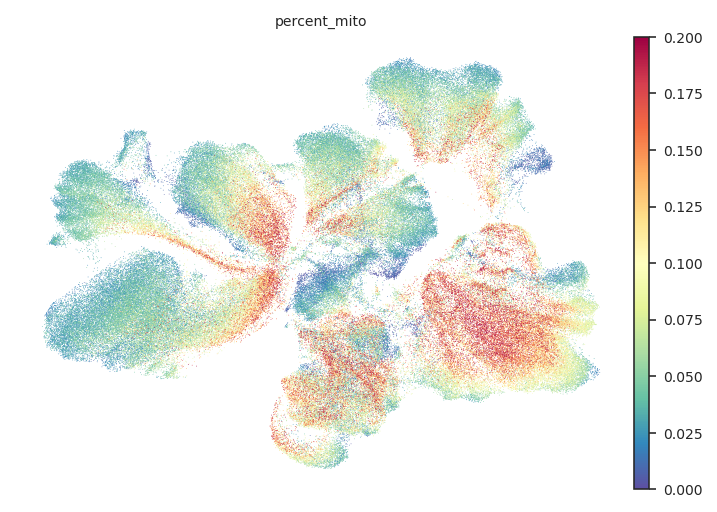

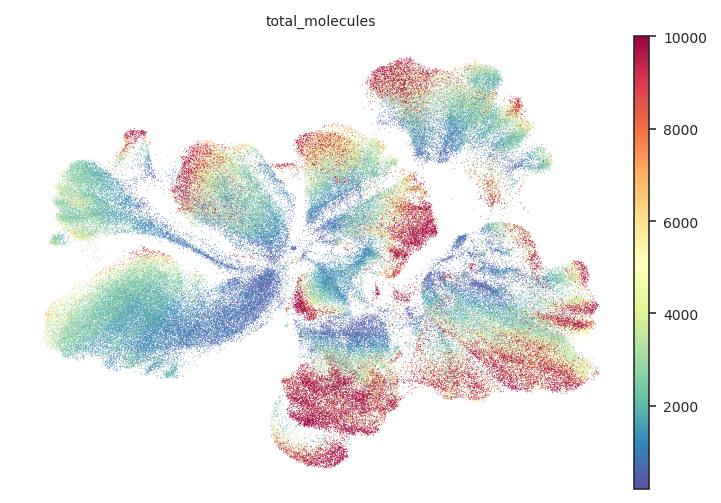

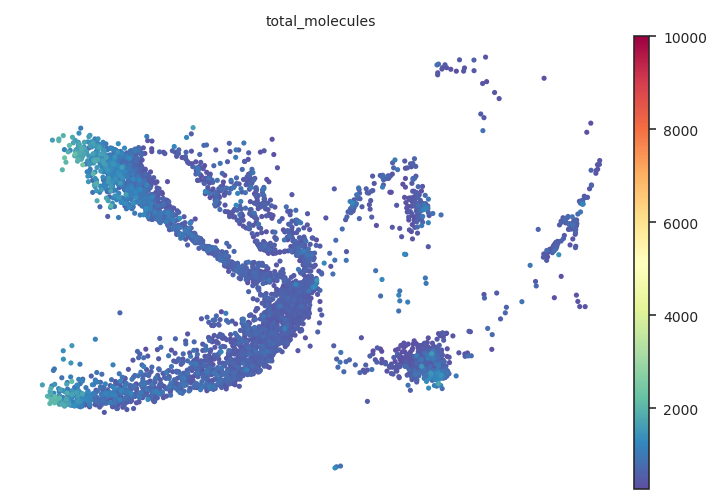

In [11]:
#plot umap
%matplotlib inline
sc.pl.umap(adata_ndf_noRBP, color=['batch'], palette= color_map_clusters, use_raw= False)
sc.pl.umap(adata_ndf_noRBP, color=['PTPRC'], cmap= 'Spectral_r', use_raw= False)
sc.pl.umap(adata_ndf_noRBP, color=['CD68','CD3E','CD19'], cmap= 'Spectral_r', use_raw= False)
sc.pl.umap(adata_ndf_noRBP, color=['Limited'], palette= ['black','orange','blue'] , use_raw= False)
sc.pl.umap(adata_ndf_noRBP, color=['FDR_emptydrops'], cmap= 'Spectral_r', use_raw= False, vmin=0, vmax=0.05)
sc.pl.umap(adata_ndf_noRBP, color=['pheno'], cmap= 'Spectral_r' , use_raw= False)
sc.pl.umap(adata_ndf_noRBP, color=['total_molecules'], cmap= 'Spectral_r', use_raw= False, vmax=10000)
sc.pl.umap(adata_ndf_noRBP, color=['percent_mito'], cmap= 'Spectral_r', use_raw= False, vmin=0,vmax=0.2)
sc.pl.umap(adata_ndf_noRBP[adata_ndf_noRBP.obs['Limited']==True], color=['total_molecules'], cmap= 'Spectral_r', use_raw= False, vmax=10000)
sc.pl.umap(adata_ndf_noRBP[adata_ndf_noRBP.obs['Limited']==False], color=['total_molecules'], cmap= 'Spectral_r', use_raw= False, vmax=10000)


## calulate covariance matrices

/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/seaborn/matrix.py:659: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/numpy/lib/function_base.py:393: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/numpy/core/_methods.py:153: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(
/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/numpy/lib/function_base.py:2526: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar)
/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/numpy/lib/function_base.py:2455: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/home/wallet/minicon

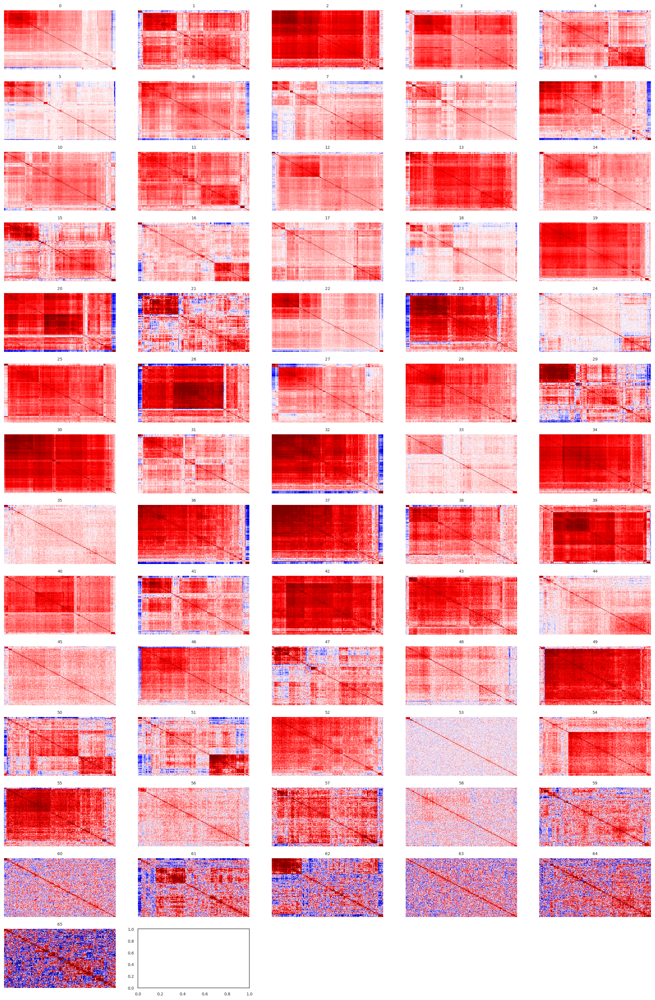

In [12]:
## Covariance matrices
from matplotlib import rcParams

rcParams['figure.figsize'] = (20, 30)
high_genes = adata_ndf_noRBP.var["n_cells"].sort_values(
    ascending=False)[:300].index
not_able_to_plot = []
ncol = 5
nrow = int(np.ceil(len(set(adata_ndf_noRBP.obs["pheno"])) / ncol))
for i, cluster in enumerate(set(adata_ndf_noRBP.obs["pheno"])):
    plt.subplot(nrow, ncol, i + 1)
    subsetcluster = adata_ndf_noRBP[adata_ndf_noRBP.obs["pheno"] == i][:, high_genes]
    subsetcluster_cov = np.corrcoef(np.log2(subsetcluster.X.todense() + .1).T)
    if True not in np.isnan(subsetcluster_cov):
        tmp = sns.clustermap(subsetcluster_cov,
                             cmap='seismic',
                             yticklabels="",
                             xticklabels="",
                             vmax=.4,
                             center=0,
                             vmin=-.4)
        plt.close()
        subsetcluster_cov_cls = subsetcluster_cov[:, tmp.dendrogram_row.
                                                  reordered_ind][
                                                      tmp.dendrogram_row.
                                                      reordered_ind, :]
        sns.heatmap(subsetcluster_cov_cls,
                    cmap='seismic',
                    cbar=False,
                    yticklabels=False,
                    xticklabels=False,
                    vmax=.4,
                    center=0,
                    vmin=-.4).set_title(cluster)
    else:
        not_able_to_plot.append(cluster)

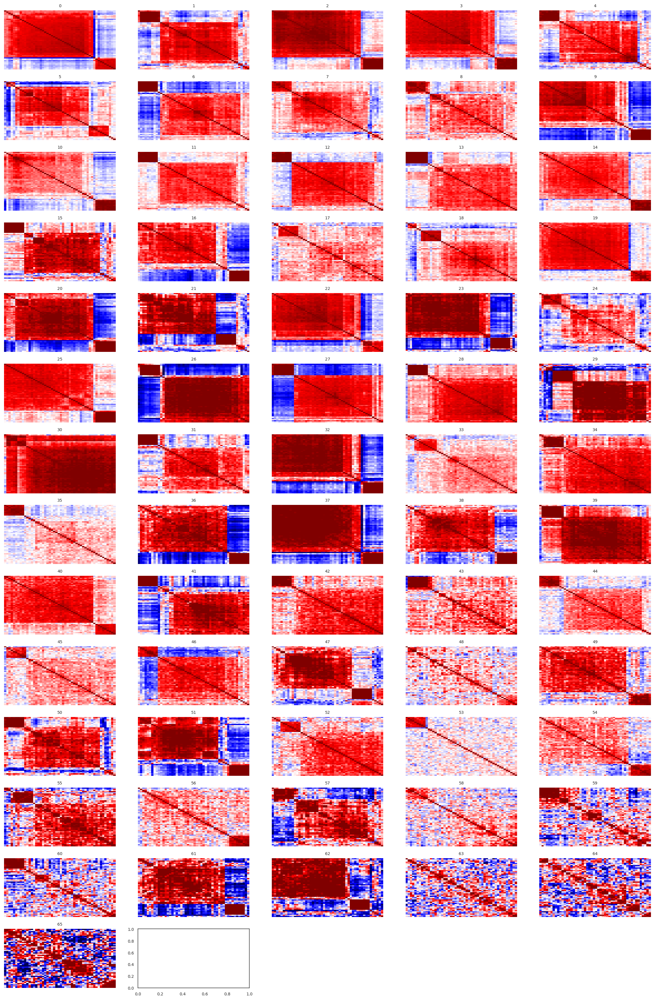

In [13]:
# Covariance matrices
from matplotlib import rcParams

rcParams['figure.figsize'] = (20, 30)
high_genes = adata_ndf_noRBP.var["n_cells"].sort_values(
    ascending=False)[:50].index
not_able_to_plot = []
ncol = 5
nrow = int(np.ceil(len(set(adata_ndf_noRBP.obs["pheno"])) / ncol))
for i, cluster in enumerate(set(adata_ndf_noRBP.obs["pheno"])):
    plt.subplot(nrow, ncol, i + 1)
    subsetcluster = adata_ndf_noRBP[adata_ndf_noRBP.obs["pheno"] == i][:, high_genes]
    subsetcluster_cov = np.corrcoef(np.log2(subsetcluster.X.todense() + .1).T)
    if True not in np.isnan(subsetcluster_cov):
        tmp = sns.clustermap(subsetcluster_cov,
                             cmap='seismic',
                             yticklabels="",
                             xticklabels="",
                             vmax=.4,
                             center=0,
                             vmin=-.4)
        plt.close()
        subsetcluster_cov_cls = subsetcluster_cov[:, tmp.dendrogram_row.
                                                  reordered_ind][
                                                      tmp.dendrogram_row.
                                                      reordered_ind, :]
        sns.heatmap(subsetcluster_cov_cls,
                    cmap='seismic',
                    cbar=False,
                    yticklabels=False,
                    xticklabels=False,
                    vmax=.4,
                    center=0,
                    vmin=-.4).set_title(cluster)
    else:
        not_able_to_plot.append(cluster)

In [14]:
adata_ndf_noRBP

AnnData object with n_obs × n_vars = 196887 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'neighbors', 'pca', 'umap', 'batch_colors', 'Limited_colors', 'pheno_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [15]:
adata_ndf_noRBP.obs['true_cell_emptydrops'] = adata_ndf_noRBP.obs['FDR_emptydrops']<0.05

In [16]:
# calculate observed distribution
dist_observed= pd.crosstab(adata_ndf_noRBP.obs['true_cell_emptydrops'], adata_ndf_noRBP.obs['pheno'], values=None, rownames=None, colnames=None, aggfunc=None, margins=False, margins_name='All', dropna=True, normalize=False)
expected_sums = (list(dist_observed.sum(axis=1)))

#create dataframe containing the expected distribution
expected_fractions1 = [expected_sums[0]/(expected_sums[0]+expected_sums[1])]* len(set(adata_ndf_noRBP.obs['pheno']))
expected_fractions2 = [expected_sums[1]/(expected_sums[0]+expected_sums[1])]* len(set(adata_ndf_noRBP.obs['pheno']))

expected_fractions = pd.DataFrame(np.array([expected_fractions1,expected_fractions2]))
expected_fractions = expected_fractions.append(dist_observed.sum(axis=0), ignore_index=True)

expected_cells = expected_fractions.iloc[2]*expected_fractions.iloc[0]
expected_cells2 = expected_fractions.iloc[2]*expected_fractions.iloc[1]
expected_fractions = expected_fractions.append([expected_cells,expected_cells2])

expected_fractions = expected_fractions.set_index(pd.Index([0,1,2,3,4]))

expected_fractions = expected_fractions.drop([0,1,2])
expected_fractions


,0,1,2,3,4,5,6,7,8,9,...,58,59,60,61,62,63,64,65,66,-1
3,196.150604,171.668256,143.653324,129.430831,127.019458,121.014064,116.97463,108.788249,101.538771,87.838486,...,3.701534,2.472809,1.443752,1.336239,1.198007,0.98298,0.829389,0.32254,NaN,NaN
4,12574.849396,11005.331744,9209.346676,8297.569169,8142.980542,7757.985936,7499.02537,6974.211751,6509.461229,5631.161514,...,237.298466,158.527191,92.556248,85.663761,76.801993,63.01702,53.170611,20.67746,NaN,NaN


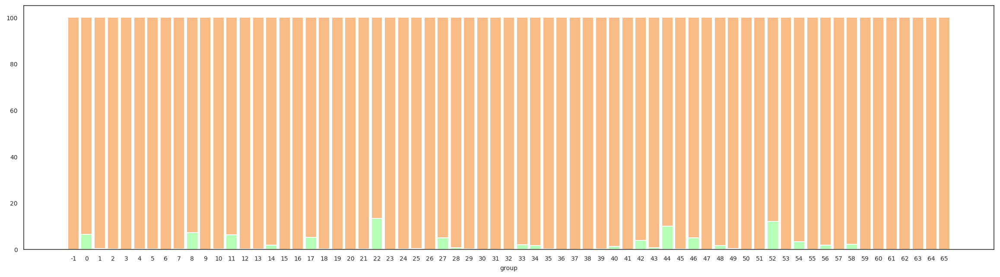

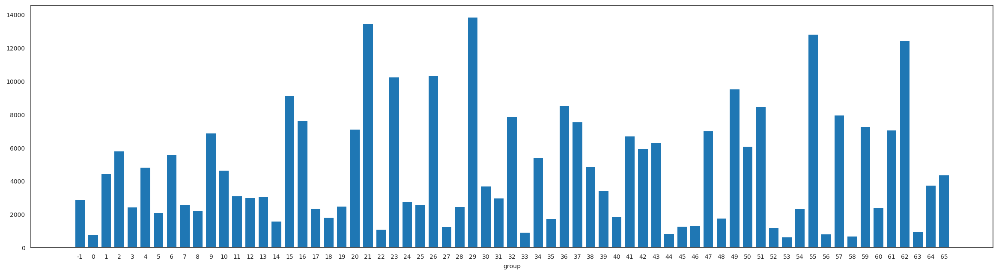

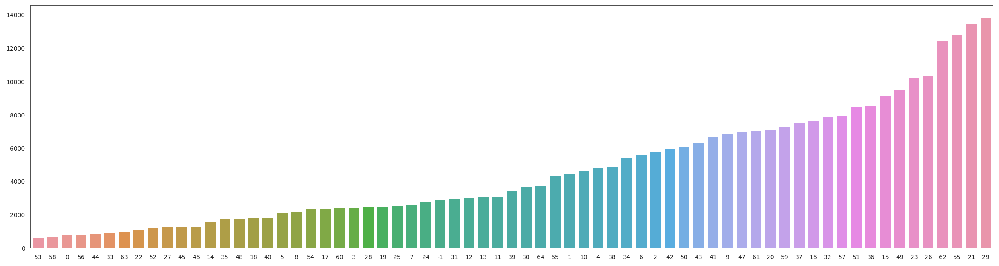

In [17]:
#stacked bars for drop frequency


#calculate mean copies per cluster
clusters_copy = list(set(adata_ndf_noRBP.obs['pheno']))
copy_means = []
for i in clusters_copy:
    a = adata_ndf_noRBP.obs[adata_ndf_noRBP.obs['pheno']==i]
    b = np.mean(a['total_molecules'])
    copy_means.append(b)

copy_df = pd.DataFrame([copy_means], columns=clusters_copy)
copy_df_sorted = copy_df.sort_values(by=[0],axis=1)

# Data showing drop frequency
dist_observed_tp = dist_observed.set_index(pd.Index(['drop','cell']))
r = list(dist_observed_tp.columns.values)

# From raw value to percentage
totals = [i+j for i,j in zip(dist_observed_tp.loc['drop'], dist_observed_tp.loc['cell'])]
greenBars = [(i / j) * 100 for i,j in zip(dist_observed_tp.loc['drop'], totals)]
orangeBars = [(i / j) * 100 for i,j in zip(dist_observed_tp.loc['cell'], totals)]

# plot
barWidth = 0.85
names = dist_observed_tp.columns.values
f, ax = plt.subplots(figsize=(20,5))
# Create green Bars
plt.bar(r, greenBars, color='#b5ffb9', edgecolor='white', width=barWidth)
# Create orange Bars
plt.bar(r, orangeBars, bottom=greenBars, color='#f9bc86', edgecolor='white', width=barWidth)

# Custom x axis
plt.xticks(r, names)
plt.xlabel("group")

# plot copies per cluster
barWidth = 0.85
f, ax = plt.subplots(figsize=(20,5))
plt.bar(x = copy_df_sorted.columns.values, height= list(copy_df_sorted.iloc[0]))
# Custom x axis
plt.xticks(r, names)
plt.xlabel("group")
# overlay

X0 = greenBars
X1 = orangeBars

# sort bars by copy numbers

a4_dims = (4, 3)
f, ax = plt.subplots(figsize=(20,5))
ax = sns.barplot(x = copy_df_sorted.columns.values, y= list(copy_df_sorted.iloc[0]), order=copy_df_sorted.columns.values)

In [18]:
### use manual correction if necessary bc of nan and -1 column which incorporates unclustered cells etc
expected_fractions
dist_observed

expected_fractions = expected_fractions[list(set(adata_ndf_noRBP.obs['pheno']))]
dist_observed = dist_observed[list(set(adata_ndf_noRBP.obs['pheno']))]

In [19]:
#calculated the xisquare on the observed distribution

import statsmodels as statsmodels

xisquared = scipy.stats.chisquare(dist_observed, f_exp=expected_fractions , ddof=0, axis=0)

xisquared = pd.DataFrame(xisquared)

#merged df of observed and expected to calculate fold changes
observed_expected = expected_fractions.append(dist_observed)
observed_expected.loc['fold_change'] = observed_expected.iloc[2]/observed_expected.iloc[0]
observed_expected = observed_expected.drop([3,4,False,True])
observed_expected

# correct p 
p_values_chi2 = statsmodels.stats.multitest.multipletests(np.array(xisquared.iloc[1]), alpha=0.05, method='fdr_bh', is_sorted=False, returnsorted=False) # correct p values with BH method
p_values_dict_chi2 = dict(zip(list(set(adata_ndf_noRBP.obs['pheno'])), p_values_chi2[1])) #clusters with more empty drops than exp. (fold >1 and sig)

# dictionary with all clusters fulfilling the desired fold change and significant deviation
p_values_chi2_sig = dict( (k,v) for k, v in p_values_dict_chi2.items() if v <= 0.05) # dictionary with values that do not significantly deviate from sd of healthy cells


# dict for fold changes 
fold_values_dict_chi2 = dict(zip(list(set(adata_ndf_noRBP.obs['pheno'])), observed_expected.iloc[0])) #clusters with more empty drops than exp. (fold >1 and sig)
fold_values_chi2_sig = dict( (k,v) for k, v in fold_values_dict_chi2.items() if v >2) # dictionary with values that do not significantly deviate from sd of healthy cells
empty_drop_dict_ns = dict( (k,v) for k, v in fold_values_dict_chi2.items() if v <=2)


/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/scipy/stats/_distn_infrastructure.py:1932: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/home/wallet/miniconda3/envs/2020_Peer_PDAC_dev_Lowe/lib/python3.8/site-packages/statsmodels/stats/multitest.py:325: RuntimeWarning: invalid value encountered in less_equal
  reject = pvals_sorted <= ecdffactor*alpha


In [20]:
empty_drop_dict_ns

{1: 0.19805641829664375,
 2: 0.027844813394904272,
 3: 0.0077261344393775855,
 4: 0.02361842862900904,
 5: 0.016527004675881436,
 6: 0.0,
 7: 0.027576507802047828,
 9: 0.0,
 10: 0.057556696358411354,
 12: 0.026569326635639632,
 13: 0.06746956986594292,
 14: 1.1386806856825595,
 15: 0.0,
 16: 0.0,
 18: 0.04851574882312587,
 19: 0.0,
 20: 0.0,
 21: 0.017283816012910784,
 23: 0.0,
 24: 0.08164029457132906,
 25: 0.1475419049674472,
 26: 0.0,
 28: 0.4513150541744121,
 29: 0.07167868064657056,
 30: 0.0,
 31: 0.0,
 32: 0.0,
 33: 1.3218365446587825,
 34: 0.9973481653711429,
 35: 0.10094284483819367,
 36: 0.0,
 37: 0.0,
 38: 0.0,
 39: 0.04958730763186209,
 40: 0.8157636325216592,
 41: 0.0,
 43: 0.4054777085804666,
 45: 0.07677846099131476,
 47: 0.0,
 48: 1.0896758982533041,
 49: 0.1841814283469163,
 50: 0.0,
 51: 0.0,
 53: 0.0,
 55: 0.0,
 56: 1.1523563702767243,
 57: 0.0,
 58: 1.3507911809260358,
 59: 0.0,
 60: 0.0,
 61: 0.0,
 62: 0.0,
 63: 0.0,
 64: 0.0,
 65: 0.0}

## filter out empty drops clusters

In [21]:
# create obs element labeling clusters containin non-significant proportion of emptydrops
adata_ndf_noRBP.obs['empty_droplet_sig'] = adata_ndf_noRBP.obs['pheno'].isin(empty_drop_dict_ns)


In [22]:
adata_ndf_noRBP

AnnData object with n_obs × n_vars = 196887 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'neighbors', 'pca', 'umap', 'batch_colors', 'Limited_colors', 'pheno_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [23]:
#remove significant empty drops clusters True is cell, false is drop
adata_nodrops = adata_ndf_noRBP[adata_ndf_noRBP.obs['empty_droplet_sig'] == True]

In [24]:
adata_nodrops

View of AnnData object with n_obs × n_vars = 157618 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'neighbors', 'pca', 'umap', 'batch_colors', 'Limited_colors', 'pheno_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [25]:
#remove all residual empty drops
adata_nodrops = adata_nodrops[adata_nodrops.obs['true_cell_emptydrops']==True]

In [26]:
adata_nodrops

View of AnnData object with n_obs × n_vars = 157310 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'neighbors', 'pca', 'umap', 'batch_colors', 'Limited_colors', 'pheno_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [27]:
adata_nodrops.obs['true_cell_emptydrops'] = pd.Categorical(adata_nodrops.obs['true_cell_emptydrops'])

Trying to set attribute `.obs` of view, copying.


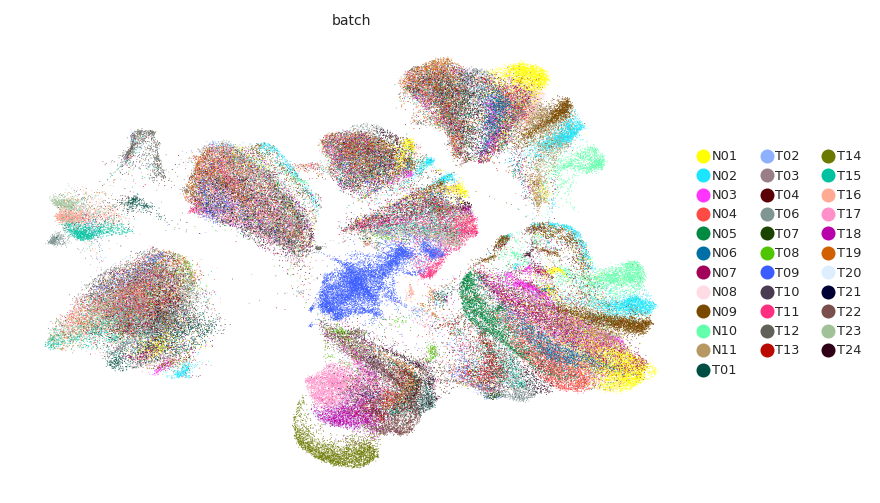

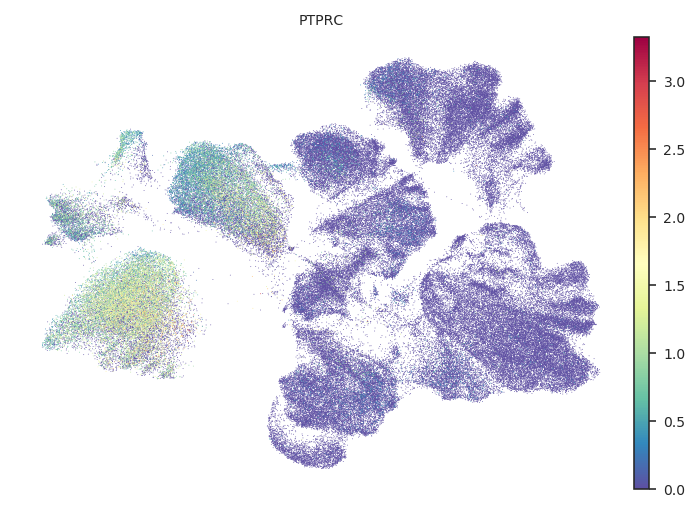

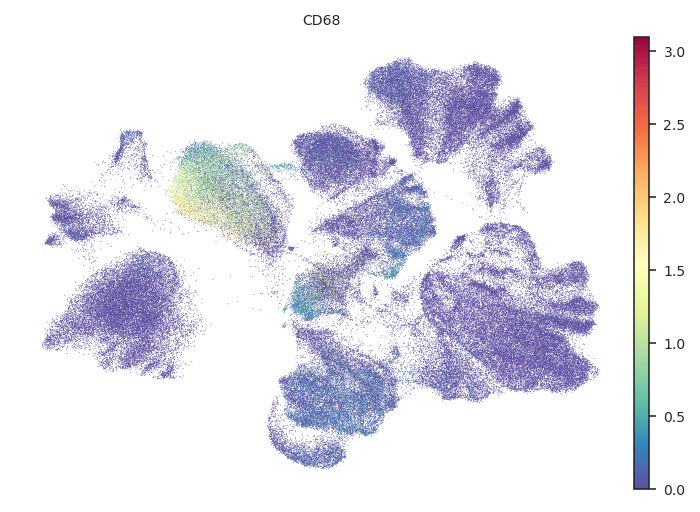

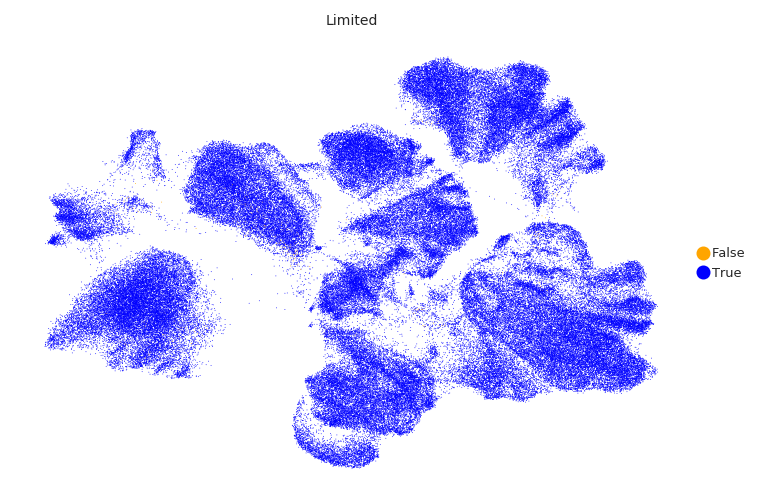

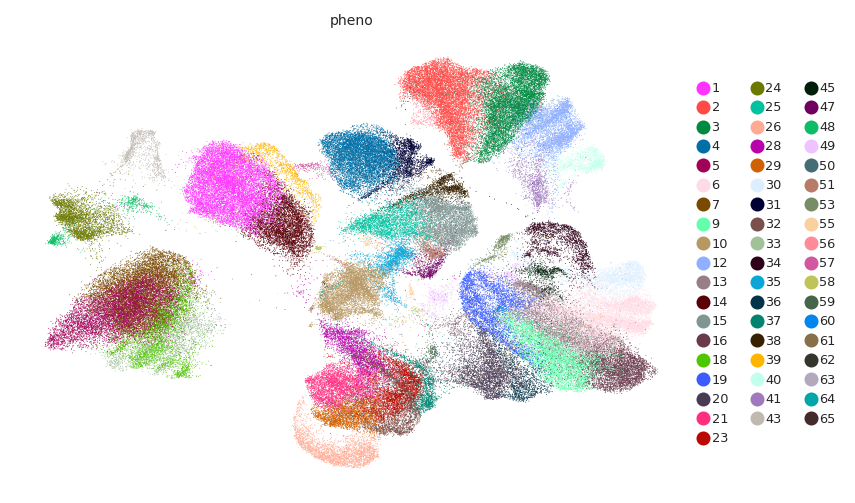

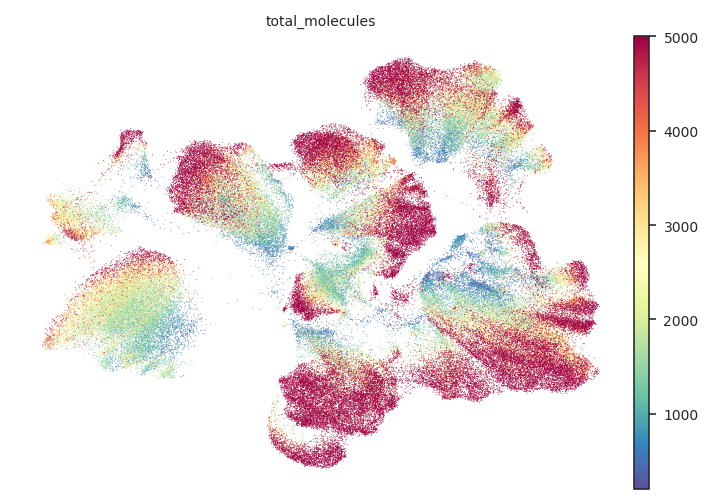

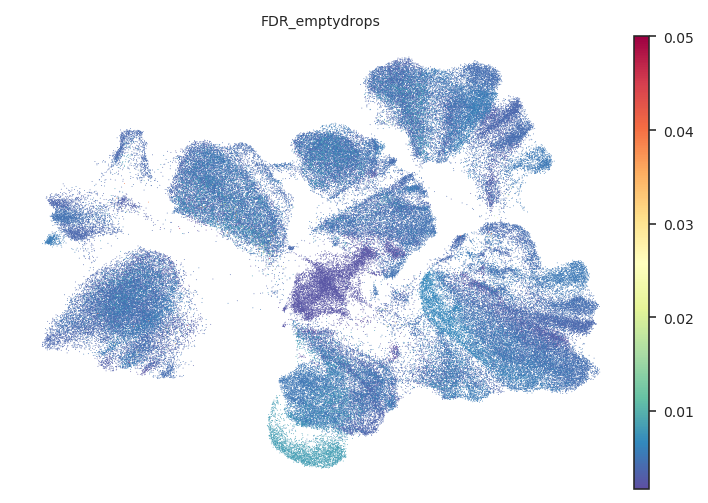

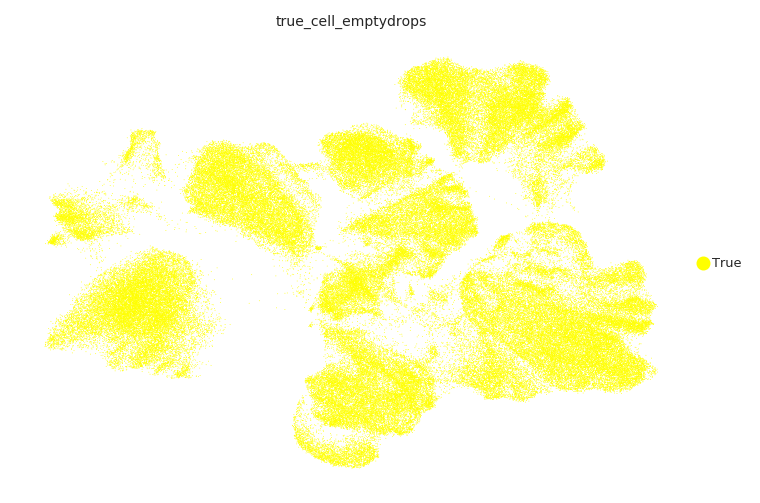

In [28]:
#plot umap
%matplotlib inline
sc.pl.umap(adata_nodrops, color=['batch'], palette= color_map_clusters, use_raw= False)
sc.pl.umap(adata_nodrops, color=['PTPRC'], cmap= 'Spectral_r', use_raw= False)
sc.pl.umap(adata_nodrops, color=['CD68'], cmap= 'Spectral_r', use_raw= False)
sc.pl.umap(adata_nodrops, color=['Limited'], palette= ['orange','blue'] , use_raw= False)
sc.pl.umap(adata_nodrops, color=['pheno'], cmap= 'Spectral_r' , use_raw= False)
sc.pl.umap(adata_nodrops, color=['total_molecules'], cmap= 'Spectral_r', use_raw= False, vmax=5000)
sc.pl.umap(adata_nodrops, color=['FDR_emptydrops'], cmap= 'Spectral_r', use_raw= False, vmax=0.05)
sc.pl.umap(adata_nodrops, color=['true_cell_emptydrops'], palette= color_map_clusters, use_raw= False)

In [29]:
adata_nodrops.write(adata_save_path)